In 1.SampleStreetNetwork.Ipynb:
- Random locations on the street network of Manchester are selected. At each location, four images are sampled from Google Street View pointing in the four Cardinal directions.  

In 2.CalculateEmbeddings.Ipynb :
- An embedding is calculated for each of the four locations.

This results in a dataframe containing one row per location sampled on the road network. This contains:
- A column called Image_files which contains a list of file paths of four images
- A column called Embedding which contains a list of embeddings of those four images

The aim of this project is to train a machine learning model, which will be able to predict the imd ranking of an LSOA.

LOCATION|MEAN EMBEDDING ACROSS 4 IMAGES|LSOACD|IMD RANK

In [4]:
import pickle
import os
import pandas as pd
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point, LineString
import random 
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics.pairwise import cosine_similarity
from scipy.stats import ttest_ind
import hdbscan
from sklearn.utils import check_random_state
from itertools import combinations

from functions import *

In [5]:
data_dir = os.path.join("../../data/embeddings/")
lsoas_file = os.path.join("../../data/SpatialData/", "LSOAs_2011", "LSOA_2011_EW_BSC_V4.shp")

## Spatial data
### Get LSOAs spatial data, keep just those in Greater Manchester

In [6]:
lsoas =  gpd.read_file(lsoas_file)
manc_lads = ['Manchester', 'Rochdale', 'Bolton', 'Bury', 'Wigan', 'Oldham',  'Trafford', 'Salford', 'Tameside', 'Stockport']
manc_lads_pattern = '|'.join(manc_lads)
gm_lsoa=lsoas[lsoas['LSOA11NMW'].str.contains(manc_lads_pattern)].copy()

### Find distance between centre of each LSOA and the middle of Manchester

In [7]:
# Reference point (Manchester city centre) in WGS84
ref_point = gpd.GeoSeries([Point(-2.2425, 53.480833)], crs="EPSG:4326")

# Project the reference point too
ref_point_metric = ref_point.to_crs(epsg=27700).iloc[0]

# Calculate distance from centroid of each LSOA to reference point
gm_lsoa["distance_to_centre_m"] = gm_lsoa.geometry.centroid.distance(ref_point_metric)

gm_lsoa = gm_lsoa.to_crs(epsg=4326)

## Embeddings 
### Get embeddings (four per location)

In [25]:
points_data_cache = data_dir + "sample_points_cache/points_data_cache_with_embeddings_and_attn_stats.pkl"
with open(points_data_cache, "rb") as f:
    point_records = pickle.load(f)

### Join image embeddings points to gentrification LSOAs

In [26]:
point_coords = [Point(rec['longitude'], rec['latitude']) for rec in point_records]
points_labels_gdf = gpd.GeoDataFrame(point_records, geometry=point_coords, crs="EPSG:4326")

# Perform spatial join to get gentrification label for each point
points_labels_gdf = gpd.sjoin(points_labels_gdf, gm_lsoa, how='inner', predicate='within')
# sjoin may add an index from the polygon ('index_right'); we can drop it
if 'index_right' in points_labels_gdf.columns:
    points_labels_gdf = points_labels_gdf.drop(columns=['index_right'])

print(f"Points after spatial join: {len(points_labels_gdf)} / {len(point_records)}"
      f" `(some points may lie outside the label polygons and were dropped)")

Points after spatial join: 18897 / 18897 `(some points may lie outside the label polygons and were dropped)


### Expand so there is one row per each image

In [27]:
expanded_rows = []

for _, row in points_labels_gdf.iterrows():
    embeddings = row['embedding']      # list of 4 embeddings
    images = row['image_files']        # list of 4 image paths

    # Skip if lengths don't match
    if len(embeddings) != len(images):
        print(f"Skipping row {row.name}: {len(embeddings)} embeddings, {len(images)} images")
        continue

    for emb, img in zip(embeddings, images):
        new_row = row.to_dict()        # copy all other columns
        new_row['embedding'] = emb     # single embedding
        new_row['image_files'] = img    # single image
        expanded_rows.append(new_row)

# Create new DataFrame
expanded_gdf = pd.DataFrame(expanded_rows)
print(f"Original rows: {len(points_labels_gdf)}, Expanded rows: {len(expanded_gdf)}")
expanded_gdf = pd.DataFrame(expanded_rows)


Skipping row 0: 768 embeddings, 4 images
Skipping row 1: 768 embeddings, 4 images
Skipping row 2: 768 embeddings, 4 images
Skipping row 3: 768 embeddings, 4 images
Skipping row 4: 768 embeddings, 4 images
Skipping row 5: 768 embeddings, 4 images
Skipping row 6: 768 embeddings, 4 images
Skipping row 7: 768 embeddings, 4 images
Skipping row 8: 768 embeddings, 4 images
Skipping row 9: 768 embeddings, 4 images
Skipping row 10: 768 embeddings, 4 images
Skipping row 11: 768 embeddings, 4 images
Skipping row 12: 768 embeddings, 4 images
Skipping row 13: 768 embeddings, 4 images
Skipping row 14: 768 embeddings, 4 images
Skipping row 15: 768 embeddings, 4 images
Skipping row 16: 768 embeddings, 4 images
Skipping row 17: 768 embeddings, 4 images
Skipping row 18: 768 embeddings, 4 images
Skipping row 19: 768 embeddings, 4 images
Skipping row 20: 768 embeddings, 4 images
Skipping row 21: 768 embeddings, 4 images
Skipping row 22: 768 embeddings, 4 images
Skipping row 23: 768 embeddings, 4 images
Sk

Skipping row 2654: 768 embeddings, 4 images
Skipping row 2655: 768 embeddings, 4 images
Skipping row 2656: 768 embeddings, 4 images
Skipping row 2657: 768 embeddings, 4 images
Skipping row 2658: 768 embeddings, 4 images
Skipping row 2659: 768 embeddings, 4 images
Skipping row 2660: 768 embeddings, 4 images
Skipping row 2661: 768 embeddings, 4 images
Skipping row 2662: 768 embeddings, 4 images
Skipping row 2663: 768 embeddings, 4 images
Skipping row 2664: 768 embeddings, 4 images
Skipping row 2665: 768 embeddings, 4 images
Skipping row 2666: 768 embeddings, 4 images
Skipping row 2667: 768 embeddings, 4 images
Skipping row 2668: 768 embeddings, 4 images
Skipping row 2669: 768 embeddings, 4 images
Skipping row 2670: 768 embeddings, 4 images
Skipping row 2671: 768 embeddings, 4 images
Skipping row 2672: 768 embeddings, 4 images
Skipping row 2673: 768 embeddings, 4 images
Skipping row 2674: 768 embeddings, 4 images
Skipping row 2675: 768 embeddings, 4 images
Skipping row 2676: 768 embedding

Skipping row 6436: 768 embeddings, 4 images
Skipping row 6437: 768 embeddings, 4 images
Skipping row 6438: 768 embeddings, 4 images
Skipping row 6439: 768 embeddings, 4 images
Skipping row 6440: 768 embeddings, 4 images
Skipping row 6441: 768 embeddings, 4 images
Skipping row 6442: 768 embeddings, 4 images
Skipping row 6443: 768 embeddings, 4 images
Skipping row 6444: 768 embeddings, 4 images
Skipping row 6445: 768 embeddings, 4 images
Skipping row 6446: 768 embeddings, 4 images
Skipping row 6447: 768 embeddings, 4 images
Skipping row 6448: 768 embeddings, 4 images
Skipping row 6449: 768 embeddings, 4 images
Skipping row 6450: 768 embeddings, 4 images
Skipping row 6451: 768 embeddings, 4 images
Skipping row 6452: 768 embeddings, 4 images
Skipping row 6453: 768 embeddings, 4 images
Skipping row 6454: 768 embeddings, 4 images
Skipping row 6455: 768 embeddings, 4 images
Skipping row 6456: 768 embeddings, 4 images
Skipping row 6457: 768 embeddings, 4 images
Skipping row 6458: 768 embedding

Skipping row 10219: 768 embeddings, 4 images
Skipping row 10220: 768 embeddings, 4 images
Skipping row 10221: 768 embeddings, 4 images
Skipping row 10222: 768 embeddings, 4 images
Skipping row 10223: 768 embeddings, 4 images
Skipping row 10224: 768 embeddings, 4 images
Skipping row 10225: 768 embeddings, 4 images
Skipping row 10226: 768 embeddings, 4 images
Skipping row 10227: 768 embeddings, 4 images
Skipping row 10228: 768 embeddings, 4 images
Skipping row 10229: 768 embeddings, 4 images
Skipping row 10230: 768 embeddings, 4 images
Skipping row 10231: 768 embeddings, 4 images
Skipping row 10232: 768 embeddings, 4 images
Skipping row 10233: 768 embeddings, 4 images
Skipping row 10234: 768 embeddings, 4 images
Skipping row 10235: 768 embeddings, 4 images
Skipping row 10236: 768 embeddings, 4 images
Skipping row 10237: 768 embeddings, 4 images
Skipping row 10238: 768 embeddings, 4 images
Skipping row 10239: 768 embeddings, 4 images
Skipping row 10240: 768 embeddings, 4 images
Skipping r

Skipping row 14013: 768 embeddings, 4 images
Skipping row 14014: 768 embeddings, 4 images
Skipping row 14015: 768 embeddings, 4 images
Skipping row 14016: 768 embeddings, 4 images
Skipping row 14017: 768 embeddings, 4 images
Skipping row 14018: 768 embeddings, 4 images
Skipping row 14019: 768 embeddings, 4 images
Skipping row 14020: 768 embeddings, 4 images
Skipping row 14021: 768 embeddings, 4 images
Skipping row 14022: 768 embeddings, 4 images
Skipping row 14023: 768 embeddings, 4 images
Skipping row 14024: 768 embeddings, 4 images
Skipping row 14025: 768 embeddings, 4 images
Skipping row 14026: 768 embeddings, 4 images
Skipping row 14027: 768 embeddings, 4 images
Skipping row 14028: 768 embeddings, 4 images
Skipping row 14029: 768 embeddings, 4 images
Skipping row 14030: 768 embeddings, 4 images
Skipping row 14031: 768 embeddings, 4 images
Skipping row 14032: 768 embeddings, 4 images
Skipping row 14033: 768 embeddings, 4 images
Skipping row 14034: 768 embeddings, 4 images
Skipping r

Skipping row 17790: 768 embeddings, 4 images
Skipping row 17791: 768 embeddings, 4 images
Skipping row 17792: 768 embeddings, 4 images
Skipping row 17793: 768 embeddings, 4 images
Skipping row 17794: 768 embeddings, 4 images
Skipping row 17795: 768 embeddings, 4 images
Skipping row 17796: 768 embeddings, 4 images
Skipping row 17797: 768 embeddings, 4 images
Skipping row 17798: 768 embeddings, 4 images
Skipping row 17799: 768 embeddings, 4 images
Skipping row 17800: 768 embeddings, 4 images
Skipping row 17801: 768 embeddings, 4 images
Skipping row 17802: 768 embeddings, 4 images
Skipping row 17803: 768 embeddings, 4 images
Skipping row 17804: 768 embeddings, 4 images
Skipping row 17805: 768 embeddings, 4 images
Skipping row 17806: 768 embeddings, 4 images
Skipping row 17807: 768 embeddings, 4 images
Skipping row 17808: 768 embeddings, 4 images
Skipping row 17809: 768 embeddings, 4 images
Skipping row 17810: 768 embeddings, 4 images
Skipping row 17811: 768 embeddings, 4 images
Skipping r

### Run cluster analysis on reduced embeddings

In [29]:
expanded_gdf

""


In [78]:
k = 3 # e.g., parks, houses, roads, industrial, water
kmeans = KMeans(n_clusters=k, random_state=42)
all_embeddings = np.stack(expanded_gdf['embedding'].values)
expanded_gdf['scene_cluster2'] = kmeans.fit_predict(all_embeddings)

In [12]:
# from sklearn.cluster import AgglomerativeClustering

# # Agglomerative clustering
# agglo = AgglomerativeClustering(n_clusters=5, linkage='ward')  # choose n_clusters
# cluster_labels = agglo.fit_predict(all_embeddings)

# print(np.unique(cluster_labels, return_counts=True))

In [111]:
all_embeddings = np.stack(expanded_gdf['embedding'].values)
X = all_embeddings

umap_model = umap.UMAP(
    n_neighbors=70,   # smaller → preserves local structure → more clusters
    n_components=20,  # more dimensions → preserves small clusters
    min_dist=0.2,     # tight packing → clearer density
    metric='cosine',  # better for embeddings
    random_state=42)

X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=200,   # smaller → more clusters
    min_samples=2,         # less strict → less noise
    cluster_selection_method='leaf',  # use leaf clusters → finer structure
    metric='euclidean')
labels = clusterer.fit_predict(X_umap)
print(np.unique(labels, return_counts=True))
print(len(np.unique(labels)))

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22]), array([61504,   353,  1167,   457,   474,   237,   890,  1112,   531,
         848,  1508,  1194,   494,   267,   525,   443,   440,   273,
         392,   250,  1043,   496,   237,   445]))
24


In [110]:
all_embeddings = np.stack(expanded_gdf['embedding'].values)
X = all_embeddings

umap_model = umap.UMAP(
    n_neighbors=100,   # smaller → preserves local structure → more clusters
    n_components=20,  # more dimensions → preserves small clusters
    min_dist=0.1,     # tight packing → clearer density
    metric='cosine',  # better for embeddings
    random_state=42)

X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=200,   # smaller → more clusters
    min_samples=2,         # less strict → less noise
    cluster_selection_method='eom',  # use leaf clusters → finer structure
    metric='euclidean')
labels = clusterer.fit_predict(X_umap)
print(np.unique(labels, return_counts=True))
print(len(np.unique(labels)))

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22]), array([55470,  1311,   358,   373,   532,  1334,  1076,  1080,   248,
        1213,   482,   281,   225,   495,  2621,   448,  1081,   202,
         652,   522,   287,  3414,  1240,   635]))
24


In [112]:
all_embeddings = np.stack(expanded_gdf['embedding'].values)
X = all_embeddings

umap_model = umap.UMAP(
    n_neighbors=100,   # smaller → preserves local structure → more clusters
    n_components=20,  # more dimensions → preserves small clusters
    min_dist=0.1,     # tight packing → clearer density
    metric='cosine',  # better for embeddings
    random_state=42)

X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=50,   # smaller → more clusters
    min_samples=2,         # less strict → less noise
    cluster_selection_method='eom',  # use leaf clusters → finer structure
    metric='euclidean')
labels = clusterer.fit_predict(X_umap)
print(np.unique(labels, return_counts=True))
print(len(np.unique(labels)))

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


(array([0, 1]), array([   76, 75504]))
2


In [113]:
expanded_gdf['hdbscan_new'] = labels

In [117]:
expanded_gdf = expanded_gdf[expanded_gdf['hdbscan_new']!=0]

In [118]:
all_embeddings = np.stack(expanded_gdf['embedding'].values)
X = all_embeddings

umap_model = umap.UMAP(
    n_neighbors=100,   # smaller → preserves local structure → more clusters
    n_components=20,  # more dimensions → preserves small clusters
    min_dist=0.1,     # tight packing → clearer density
    metric='cosine',  # better for embeddings
    random_state=42)

X_umap = umap_model.fit_transform(X)

clusterer = hdbscan.HDBSCAN(
    min_cluster_size=50,   # smaller → more clusters
    min_samples=2,         # less strict → less noise
    cluster_selection_method='eom',  # use leaf clusters → finer structure
    metric='euclidean')
labels = clusterer.fit_predict(X_umap)
print(np.unique(labels, return_counts=True))
print(len(np.unique(labels)))

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.


(array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9]), array([11826,   188,    83,   402,   182,    77,   621,    83,    67,
       61859,   116]))
11


In [124]:
imd_file = os.path.join("../../", "data", "imd", "File_2_-_IoD2025_Domains_of_Deprivation.xlsx")
imd = pd.read_excel(imd_file, sheet_name="IoD2025 Domains", header=0)

# Rename columns to simpler versions
imd_col_map = {"LSOA code (2021)": "LSOA21CD",
    "Index of Multiple Deprivation (IMD) Rank (where 1 is most deprived)": "imd_rank",
    "Index of Multiple Deprivation (IMD) Decile (where 1 is most deprived 10% of LSOAs)": "imd_decile"}
imd = imd.rename(columns=imd_col_map)

In [126]:
# expanded_gdf = pd.merge(left=expanded_gdf, right=imd, on="LSOA21CD")
expanded_gdf

,point_id,latitude,longitude,date,image_files,embedding,geometry,LSOA11CD,LSOA11NM,LSOA11NMW,BNG_E,BNG_N,LONG,LAT,GlobalID,distance_to_centre_m,hdbscan_new,scene_cluster2
0,0,53.457824,-2.225911,2025-03,../data/airbnb-manchester/street_images/point0...,"[0.12573998, -0.16226359, -0.06660769, -0.2189...",POINT (-2.225911 53.457824),E01005284,Manchester 026C,Manchester 026C,385417,395474,-2.22107,53.4558,2d8f4cea-6579-41a8-93c3-6f324a58981e,3029.572583,8,0
1,0,53.457824,-2.225911,2025-03,../data/airbnb-manchester/street_images/point0...,"[0.09353803, -0.45847344, -0.11460294, -0.5377...",POINT (-2.225911 53.457824),E01005284,Manchester 026C,Manchester 026C,385417,395474,-2.22107,53.4558,2d8f4cea-6579-41a8-93c3-6f324a58981e,3029.572583,8,1
2,0,53.457824,-2.225911,2025-03,../data/airbnb-manchester/street_images/point0...,"[0.20493908, -0.5919372, 0.04155883, -0.366769...",POINT (-2.225911 53.457824),E01005284,Manchester 026C,Manchester 026C,385417,395474,-2.22107,53.4558,2d8f4cea-6579-41a8-93c3-6f324a58981e,3029.572583,8,1
3,0,53.457824,-2.225911,2025-03,../data/airbnb-manchester/street_images/point0...,"[-0.07868379, -0.34771484, 0.029631125, -0.439...",POINT (-2.225911 53.457824),E01005284,Manchester 026C,Manchester 026C,385417,395474,-2.22107,53.4558,2d8f4cea-6579-41a8-93c3-6f324a58981e,3029.572583,8,0
4,1,53.457141,-2.049611,2025-06,../data/airbnb-manchester/street_images/point1...,"[-0.013699349, -0.034277596, 0.1479875, -0.116...",POINT (-2.049611 53.457141),E01006024,Tameside 022A,Tameside 022A,396885,394635,-2.04836,53.4485,a513f04d-fa84-45d6-86a2-21926f42a246,13203.569001,8,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75575,19194,53.582965,-2.406821,2024-05,../data/airbnb-manchester/street_images/point1...,"[0.12004945, -0.10732114, -0.2026037, -0.21207...",POINT (-2.406821 53.582965),E01004931,Bolton 017E,Bolton 017E,372729,409583,-2.41338,53.5821,25f82855-fa0c-4169-baa7-72e91762279d,15675.403941,8,1
75576,19195,53.389012,-2.284530,2025-05,../data/airbnb-manchester/street_images/point1...,"[-0.30853364, -0.20946869, 0.25853848, 0.00695...",POINT (-2.28453 53.389012),E01005070,Manchester 051B,Manchester 051B,381015,388344,-2.28693,53.3916,a5a17e25-ca26-4a26-a58c-bbeebfc9e1e1,10391.220223,1,2
75577,19195,53.389012,-2.284530,2025-05,../data/airbnb-manchester/street_images/point1...,"[-0.08049778, -0.08131255, 0.03683367, 0.06557...",POINT (-2.28453 53.389012),E01005070,Manchester 051B,Manchester 051B,381015,388344,-2.28693,53.3916,a5a17e25-ca26-4a26-a58c-bbeebfc9e1e1,10391.220223,1,2
75578,19195,53.389012,-2.284530,2025-05,../data/airbnb-manchester/street_images/point1...,"[-0.17984743, -0.18323983, 0.10574951, 0.15470...",POINT (-2.28453 53.389012),E01005070,Manchester 051B,Manchester 051B,381015,388344,-2.28693,53.3916,a5a17e25-ca26-4a26-a58c-bbeebfc9e1e1,10391.220223,1,2


In [120]:
expanded_gdf['hdbscan_new'] = labels


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


### Check images to see whether clustering is logical (to me)

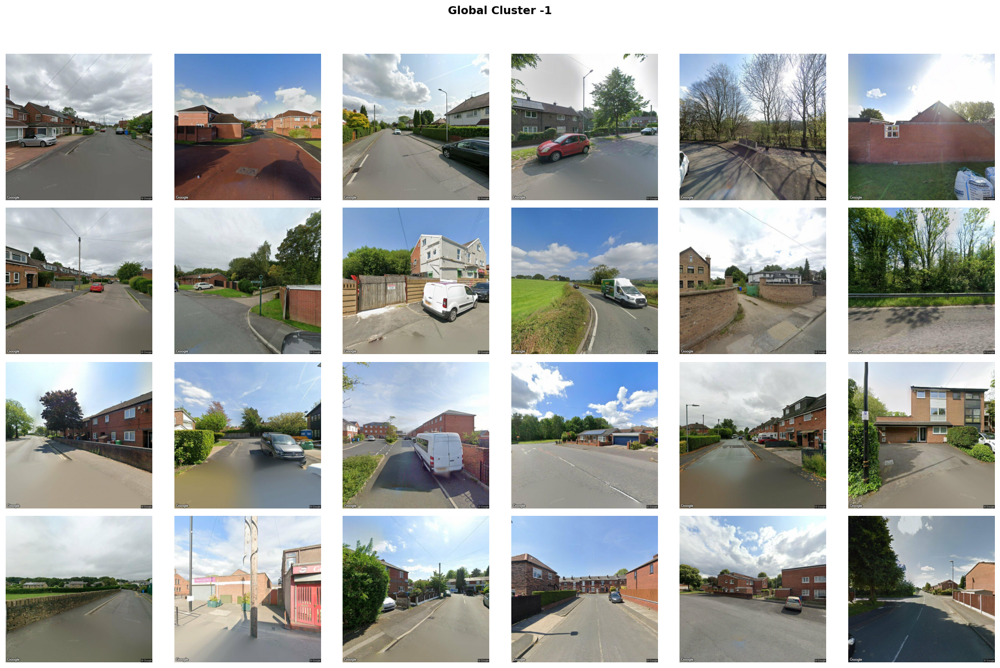

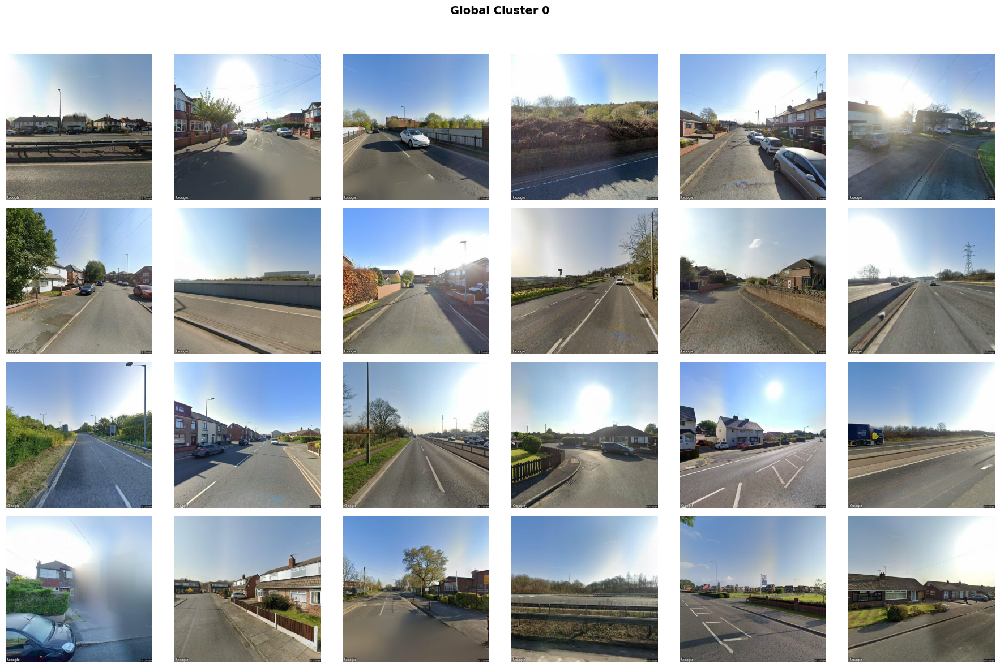

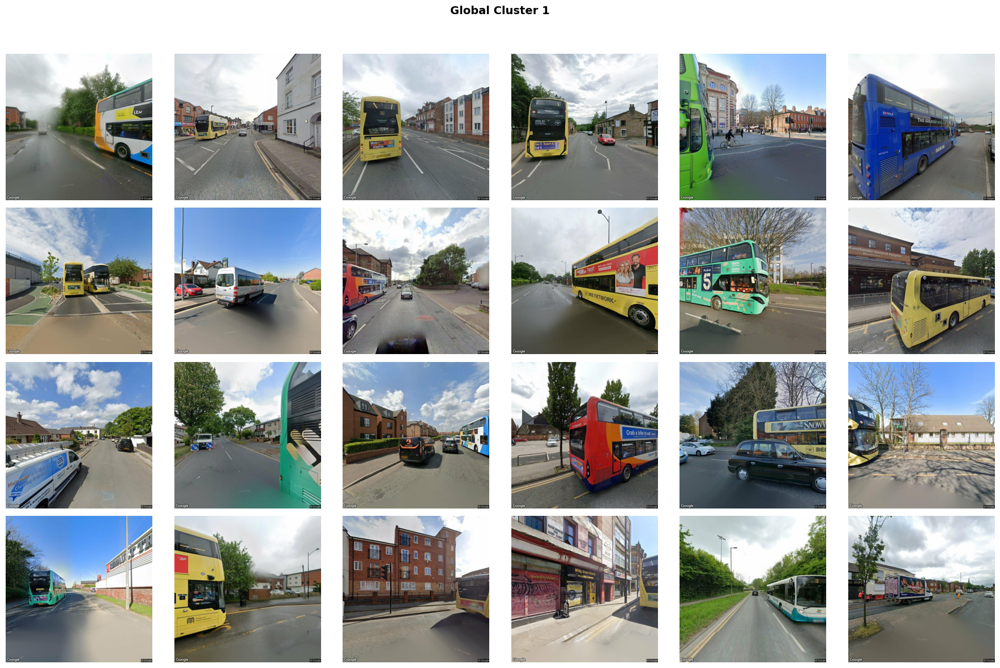

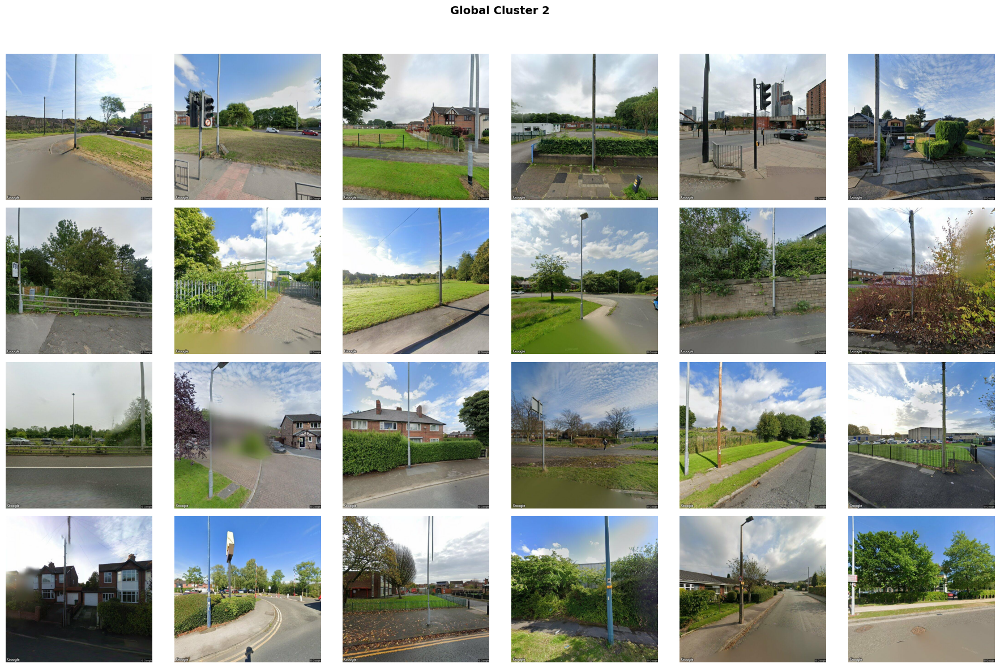

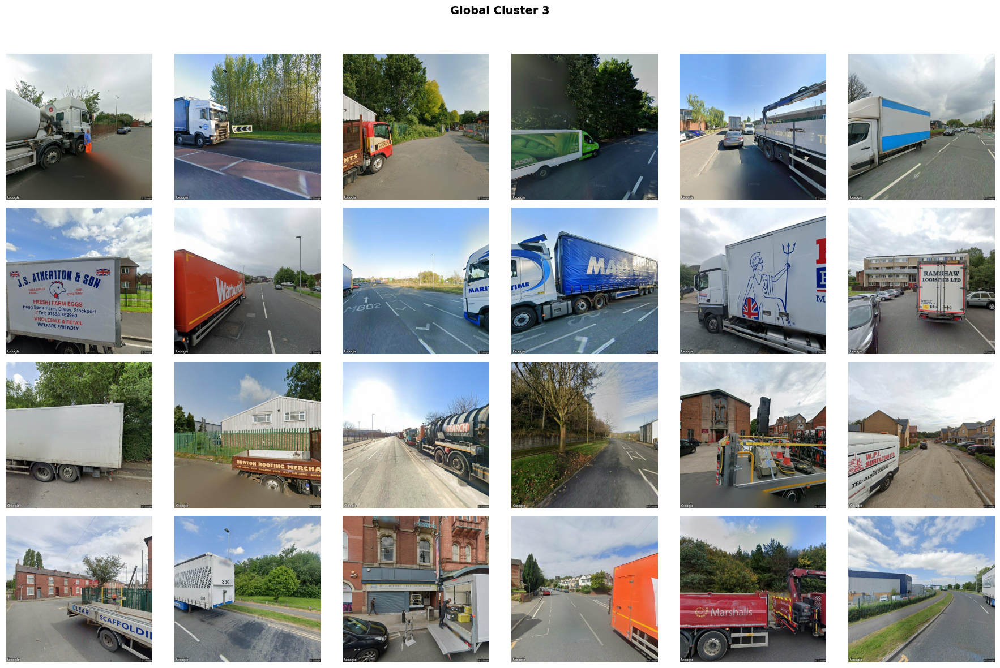

...

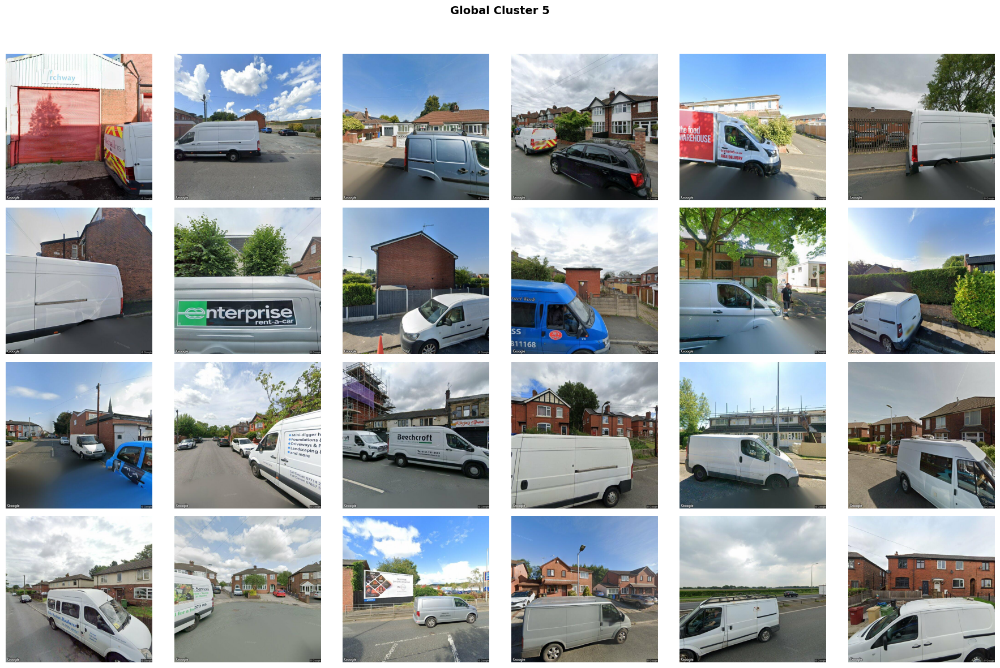

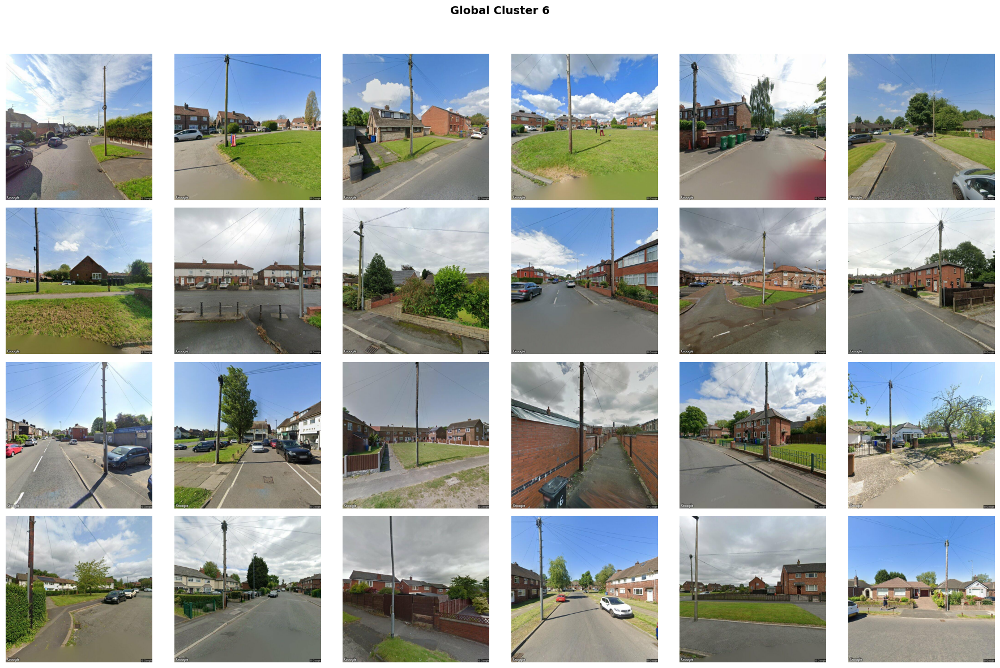

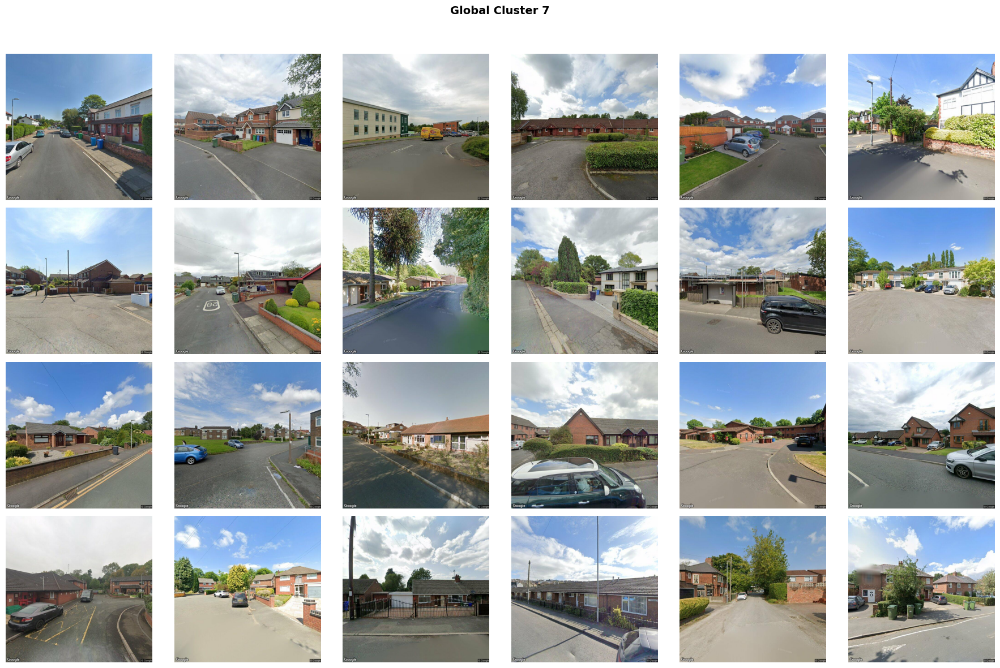

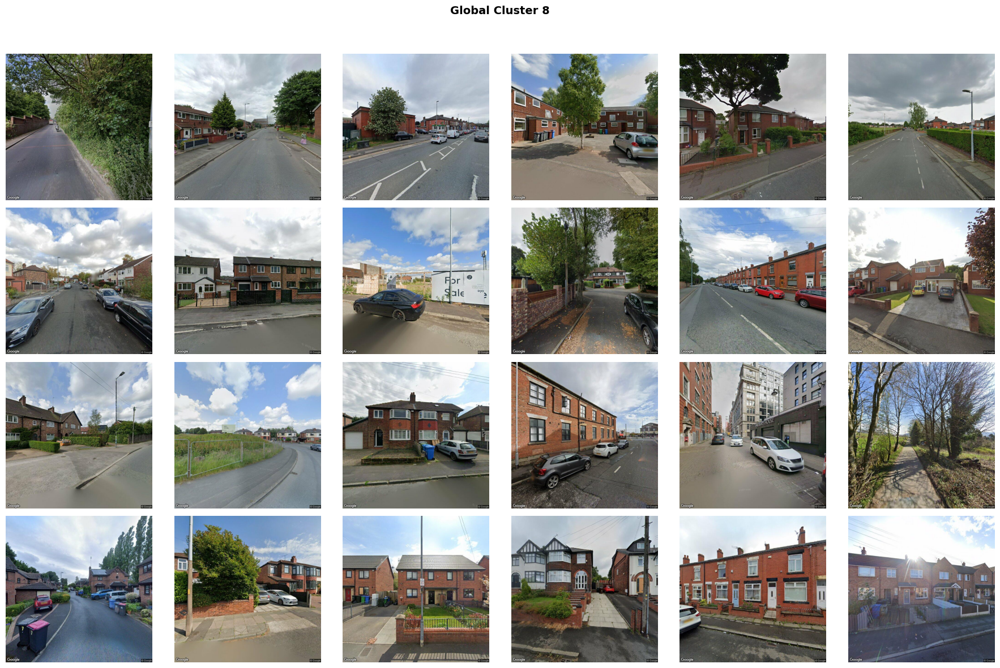

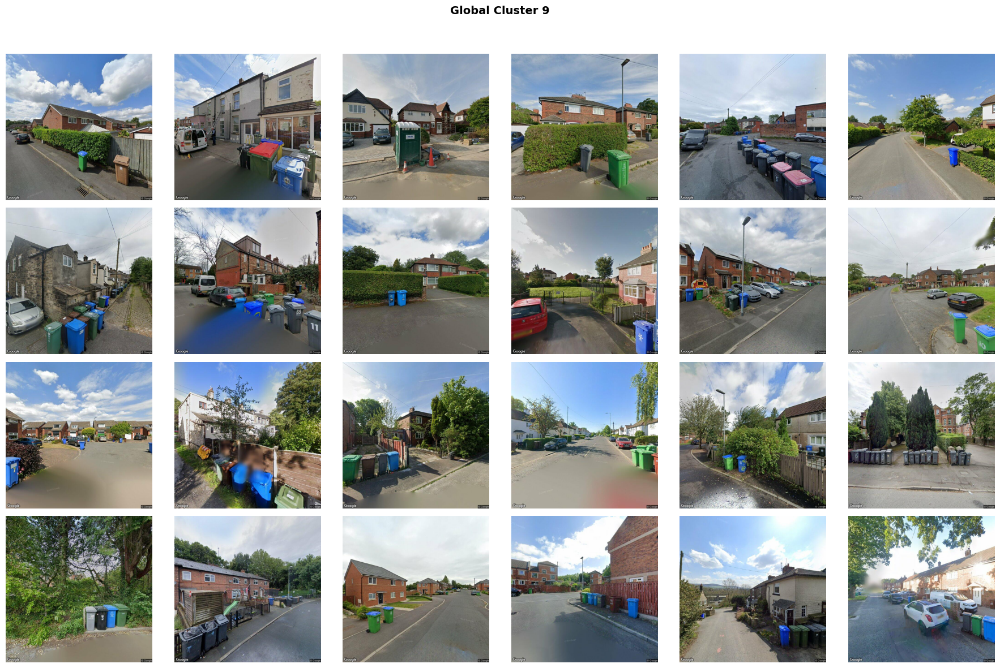

In [121]:
plot_example_images_per_cluster(expanded_gdf, k, "hdbscan_new", n_show=24)

In [107]:
# find_optimal_k_fast(all_embeddings)

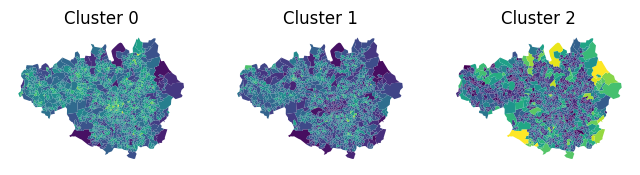

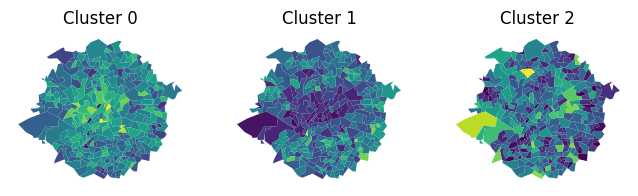

In [104]:
fig,axs=plt.subplots(ncols=3, figsize=(8,2), sharey=True, sharex=True)
for i in range(0,3):

    lsoas_with_clusters = gm_lsoa.merge(percentages, on="LSOA11CD", how="left")

    # Fill any missing percentage values with 0 (e.g., if some LSOAs had no rows in expanded_gdf)
    lsoas_with_clusters = lsoas_with_clusters.fillna(0)

    lsoas_with_clusters.plot(f'cluster_{i}_pct', ax=axs[i])
    axs[i].set_title(f"Cluster {i}")
    axs[i].axis("off")
    
fig,axs=plt.subplots(ncols=3, figsize=(8,2), sharey=True, sharex=True)
for i in range(0,3):

    lsoas_with_clusters = central_lsoas.merge(percentages, on="LSOA11CD", how="left")

    # Fill any missing percentage values with 0 (e.g., if some LSOAs had no rows in expanded_gdf)
    lsoas_with_clusters = lsoas_with_clusters.fillna(0)

    lsoas_with_clusters.plot(f'cluster_{i}_pct', ax=axs[i])
    axs[i].set_title(f"Cluster {i}")    
    axs[i].axis("off")

In [85]:
# Count rows per LSOA and cluster
counts = (
    expanded_gdf
    .groupby(["LSOA11CD", "scene_cluster2"])
    .size()
    .reset_index(name="count"))

# Pivot wider so clusters become columns
pivot = counts.pivot(index="LSOA11CD", columns="scene_cluster2", values="count").fillna(0)

# Convert counts to percentages (row-wise)
percentages = pivot.div(pivot.sum(axis=1), axis=0) * 100

# Optionally rename columns for clarity
percentages.columns = [f"cluster_{int(c)}_pct" for c in percentages.columns]

percentages = percentages.reset_index()

percentages.head()

,LSOA11CD,cluster_0_pct,cluster_1_pct,cluster_2_pct
0,E01004766,42.187500,34.375000,23.437500
1,E01004767,43.055556,31.944444,25.000000
2,E01004768,23.214286,39.285714,37.500000
3,E01004769,25.000000,30.555556,44.444444
4,E01004770,30.000000,37.500000,32.500000


### For each LSOA, compare between and within cluster group similarity

In [16]:
lsoa_sim_df = lsoa_within_between_summary(expanded_gdf)
lsoa_sim_df.head()

,LSOA11CD,mean_within,mean_between,within_minus_between,n_images
0,E01004766,0.569487,0.357428,0.212058,64
1,E01004767,0.513547,0.328592,0.184955,72
2,E01004768,0.628970,0.389832,0.239138,56
3,E01004769,0.462095,0.293362,0.168733,36
4,E01004770,0.579001,0.351007,0.227994,40


### For each LSOA, calculate mean embedding in each cluster

In [31]:
K = expanded_gdf['scene_cluster'].max() + 1  # number of clusters
lsoa_cluster_means_df = mean_embedding_per_cluster(expanded_gdf, K, 'embedding_reduced')
lsoa_cluster_weighted_means_df = weighted_mean_embedding_per_cluster(expanded_gdf, 5, 'embedding')

In [18]:
lsoa_cluster_weighted_means_df = cluster_embeddings_with_proportions(expanded_gdf, 5, 'embedding')
embedding_dim = 768
X_ml = flatten_weighted_cluster_features(lsoa_cluster_weighted_means_df, K=5, embedding_dim=embedding_dim)

In [25]:
# Assume df_lsoa_features is output of cluster_embeddings_with_proportions
embedding_dim = 768
X_ml = flatten_weighted_cluster_features(lsoa_cluster_weighted_means_df, K=5, embedding_dim=embedding_dim)

In [20]:
X_ml.to_pickle(data_dir + "xml.pkl")

In [33]:
lsoa_cluster_means_df.to_pickle(data_dir + "global_clusters_mean_embeddings.pkl")
lsoa_cluster_weighted_means_df.to_pickle(data_dir + "global_clusters_weighted_mean_embeddings.pkl")

### Keep only LSOAs where no cluster embedding is missing

In [22]:
# cluster_cols = [f'cluster_{k}' for k in range(K)]
# complete_lsoas_df = lsoa_cluster_means_df.dropna(subset=cluster_cols)

# print(f"Kept {len(complete_lsoas_df)} LSOAs out of {len(lsoa_cluster_means_df)} that have all clusters present")

In [23]:
lsoa_cluster_means_df.to_pickle(data_dir + "global_clusters_mean_embeddings.pkl")